# Default Prediction : Binary Classification ML

The banking sector faces a substantial challenge in mitigating the risk of loan defaults, which can inflict significant financial damage. The present methods of assessing loan default, while effective to a certain extent, often lack the precision required to preemptively identify potential defaulters. This is where the transformative potential of machine learning comes into play. By harnessing the power of advanced algorithms and predictive models, machine learning holds the promise of significantly enhancing loan default predictions. By analyzing an array of historical data and crucial factors, such as credit scores, employment history, and payment behavior, these models have the capacity to more accurately categorize borrowers into potential default and non-default groups.

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib as mpl
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


/kaggle/input/loan-default/Anonymize_Loan_Default_data.csv


# Data Overview and Problem Identification
We begin by loading the dataset and examining the initial rows as well as the structure of the variables.

In [2]:
df = pd.read_csv('/kaggle/input/loan-default/Anonymize_Loan_Default_data.csv', encoding= 'ISO-8859-1', index_col=0)

print(df.head())
print(df.info())

       id  member_id  loan_amnt  funded_amnt  funded_amnt_inv       term  \
2       2          2        0.0          0.0              0.0  36 months   
3  545583     703644     2500.0       2500.0           2500.0  36 months   
4  532101     687836     5000.0       5000.0           5000.0  36 months   
5  877788    1092507     7000.0       7000.0           7000.0  36 months   
6  875406    1089981     2000.0       2000.0           2000.0  36 months   

   int_rate  installment emp_length home_ownership  ...  total_acc  \
2      0.00         0.00   < 1 year           RENT  ...        1.0   
3     13.98        85.42    4 years           RENT  ...       10.0   
4     15.95       175.67    4 years           RENT  ...       15.0   
5      9.91       225.58  10+ years       MORTGAGE  ...       20.0   
6      5.42        60.32  10+ years           RENT  ...       15.0   

   total_pymnt total_pymnt_inv total_rec_prncp total_rec_int last_pymnt_d  \
2     0.000000            0.00            0.0

**From the data overview, we have identified several issues that need attention.**

1. To streamline the analysis, we may choose to omit the date variables. Nevertheless, we intend to create a new variable that gauges the repayment progress using the total_payment_inv feature. 
2. We must avoid addressing missing values in a haphazard manner, and instead employ a systematic approach.
3. Regarding significant categorical variables like purpose, home ownership, and verification status, they shouldn't be added to the model thoughtlessly or disregarded outright. Rather, these variables can be transformed in a way that minimizes the loss of information.

# Data Cleaning
As previously mentioned, our strategy involves addressing the issue of Null or NA values in the dataset to prevent the loss of valuable information. Consequently, our data cleaning procedure will concentrate on eliminating irrelevant columns. Additionally, we will ensure that each data point contains a non-null value for the loan_amnt variable, as this is a central point of interest in our analysis.

In [3]:

columns_to_drop = ['member_id', 'id', 'issue_d', 'zip_code', 'addr_state', 'earliest_cr_line', 'mths_since_last_delinq', 'last_pymnt_d', 'next_pymnt_d', 'last_credit_pull_d']

df.drop(columns=columns_to_drop, inplace=True)

In [4]:
df.dropna(subset=['loan_amnt'], inplace=True)
df = df[df['loan_amnt'] != 0]
print(df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38478 entries, 3 to 38480
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   loan_amnt            38478 non-null  float64
 1   funded_amnt          38478 non-null  float64
 2   funded_amnt_inv      38478 non-null  float64
 3   term                 38478 non-null  object 
 4   int_rate             38478 non-null  float64
 5   installment          38478 non-null  float64
 6   emp_length           37485 non-null  object 
 7   home_ownership       38478 non-null  object 
 8   annual_inc           38477 non-null  float64
 9   verification_status  38478 non-null  object 
 10  loan_status          38478 non-null  object 
 11  purpose              38478 non-null  object 
 12  dti                  38478 non-null  float64
 13  delinq_2yrs          38478 non-null  float64
 14  inq_last_6mths       38478 non-null  float64
 15  open_acc             38478 non-null 

# Feature Engineering
1. We'll set null values in the emp_length column to 0. Since a higher emp_length value suggests a more stable economy, we'll use 0 to represent the lowest value in this context.
2. We'll also transform the term column into numerical values.
3. We're going to recode the home_ownership column. We'll use 1 to indicate owned homes and 0 for rental and mortgage arrangements.
4. As for the verification_status. We'll assign 1 to "verified" and "source verified" entries, and 0 to those that aren't verified.
5. As for the purpose column, we're splitting it into two variables: one for debt consolidation and another for consumer-related purposes.
6. Lastly, we'll create a payment progress variable using total_pymnt and total_pymnt_inv, and then we'll drop both of those variables.

**We'll start with emp_length variable**

In [5]:
print(df['emp_length'].unique())
print(df['emp_length'].info())

['4 years' '10+ years' nan '3 years' '5 years' '7 years' '2 years'
 '< 1 year' '1 year' '6 years' '9 years' '8 years']
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: emp_length
Non-Null Count  Dtype 
--------------  ----- 
37485 non-null  object
dtypes: object(1)
memory usage: 601.2+ KB
None


As we can see, we have some NAN value for those who didn't employed in the last few years. The data type is also object, we need to transform this into a numerical value.

In [6]:

emp_length_mapping = {
    '< 1 year': 1,
    '1 year': 1,
    '2 years': 2,
    '3 years': 3,
    '4 years': 4,
    '5 years': 5,
    '6 years': 6,
    '7 years': 7,
    '8 years': 8,
    '9 years': 9,
    '10+ years': 10,
}

df['emp_length_numeric'] = df['emp_length'].map(emp_length_mapping)

df.loc[df['emp_length_numeric'].isnull(), 'emp_length_numeric'] = 0

print(df['emp_length_numeric'].unique())
print(df['emp_length_numeric'].info())

[ 4. 10.  0.  3.  5.  7.  2.  1.  6.  9.  8.]
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: emp_length_numeric
Non-Null Count  Dtype  
--------------  -----  
38478 non-null  float64
dtypes: float64(1)
memory usage: 601.2 KB
None


We do the same with the term column

In [7]:
print(df['term'].unique())

['36 months' '60 months']


In [8]:

term_mapping = {
    '36 months': 36,
    '60 months': 60
}

df['term_numeric'] = df['term'].map(term_mapping)

print(df['term_numeric'].unique())
print(df['term_numeric'].info())

[36 60]
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: term_numeric
Non-Null Count  Dtype
--------------  -----
38478 non-null  int64
dtypes: int64(1)
memory usage: 601.2 KB
None


We will proceed under the assumption that the financial condition could be negatively impacted by the responsibility of paying home rent or a mortgage. Thus, by distinguishing whether individuals own their homes or not, we can enhance the significance of this variable in predicting the default probability.

In [9]:
print(df['home_ownership'].unique())

['RENT' 'MORTGAGE' 'OWN' 'OTHER' 'NONE']


In [10]:
df['is_own_home'] = np.where(df['home_ownership'] == 'OWN', 1, 0)
print(df['is_own_home'].unique())
print(df['is_own_home'].info())

[0 1]
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: is_own_home
Non-Null Count  Dtype
--------------  -----
38478 non-null  int64
dtypes: int64(1)
memory usage: 601.2 KB
None



Regarding the verification status, it's clear that both "verified" and "source verified" indicate that the borrower's information has been verified under certain circumstances. To streamline this information, we can assign a value of 0 to "not verified" and a value of 1 to both "verified" and "source verified".

In [11]:
print(df['verification_status'].unique())
print(df['verification_status'].info())

['Not Verified' 'Verified' 'Source Verified']
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: verification_status
Non-Null Count  Dtype 
--------------  ----- 
38478 non-null  object
dtypes: object(1)
memory usage: 601.2+ KB
None


In [12]:
df['is_verified'] = np.where(df['verification_status'] == 'Not Verified', 0, 1)
print(df['is_verified'].unique())
print(df['is_verified'].info())

[0 1]
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: is_verified
Non-Null Count  Dtype
--------------  -----
38478 non-null  int64
dtypes: int64(1)
memory usage: 601.2 KB
None


As for the purpose we can create a new variable called "debt_consolidation" which will have a value of 1 for loans with the purpose of debt consolidation and 0 for other purposes.

Additionally, it's valuable to group loans related to "small business" purposes into a productive category. To achieve this, we can create a new variable named "productive_purpose" which will be set to 1 for loans categorized as "small_business" and 0 for all other purposes. This approach will help better capture the loan purposes in a more organized and informative manner.

In [13]:
print(df['purpose'].unique())
print(df['purpose'].info())

['other' 'debt_consolidation' 'credit_card' 'small_business'
 'major_purchase' 'wedding' 'medical' 'car' 'home_improvement' 'vacation'
 'educational' 'house' 'moving' 'renewable_energy']
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: purpose
Non-Null Count  Dtype 
--------------  ----- 
38478 non-null  object
dtypes: object(1)
memory usage: 601.2+ KB
None


In [14]:
df['debt_consol'] = np.where(df['purpose'] == 'debt_consolidation', 1, 0)
df['productive_prps'] = np.where(df['purpose'] == 'small_business', 1, 0)
print(df['debt_consol'].unique())
print(df['debt_consol'].info())
print(df['productive_prps'].unique())
print(df['productive_prps'].info())

[0 1]
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: debt_consol
Non-Null Count  Dtype
--------------  -----
38478 non-null  int64
dtypes: int64(1)
memory usage: 601.2 KB
None
[0 1]
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: productive_prps
Non-Null Count  Dtype
--------------  -----
38478 non-null  int64
dtypes: int64(1)
memory usage: 601.2 KB
None


Finally, to gauge the payment progress, we can calculate a variable by dividing "total_pymnt_inv" by "total_pymnt". This newly created variable will reflect the proportion of the debt that has been paid off. A value of 0 will represent that the debt has not been paid at all, while a value of 1 will indicate that the debt has been fully paid. This approach effectively quantifies the extent to which the debt has been settled, allowing for a clearer understanding of the payment status for each loan.

In [15]:
df['pymnt_progress'] = df['total_pymnt_inv'] / df['total_pymnt']
df[['pymnt_progress', 'total_pymnt', 'total_pymnt_inv']].head()
df.loc[df['pymnt_progress'].isnull(), 'pymnt_progress'] = 0
print(df['pymnt_progress'].unique())
print(df['pymnt_progress'].info())

[0.99999942 1.         0.99999977 ... 0.99639536 0.99999968 0.99725695]
<class 'pandas.core.series.Series'>
Int64Index: 38478 entries, 3 to 38480
Series name: pymnt_progress
Non-Null Count  Dtype  
--------------  -----  
38478 non-null  float64
dtypes: float64(1)
memory usage: 601.2 KB
None


After removing irrelevant columns and eliminating the remaining null values, we have successfully arrived at our final dataset. This dataset should now be more streamlined and representative of the relevant information needed for analysis or modeling purposes.

In [16]:
columns_to_drop2 = ['term', 'emp_length', 'home_ownership', 'verification_status', 'loan_status', 'purpose', 'revol_util']

# Drop the specified columns
df.drop(columns=columns_to_drop2, inplace=True)

In [17]:
df = df.loc[~df.isnull().any(axis=1)]
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38474 entries, 3 to 38480
Data columns (total 26 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   loan_amnt           38474 non-null  float64
 1   funded_amnt         38474 non-null  float64
 2   funded_amnt_inv     38474 non-null  float64
 3   int_rate            38474 non-null  float64
 4   installment         38474 non-null  float64
 5   annual_inc          38474 non-null  float64
 6   dti                 38474 non-null  float64
 7   delinq_2yrs         38474 non-null  float64
 8   inq_last_6mths      38474 non-null  float64
 9   open_acc            38474 non-null  float64
 10  pub_rec             38474 non-null  float64
 11  revol_bal           38474 non-null  float64
 12  total_acc           38474 non-null  float64
 13  total_pymnt         38474 non-null  float64
 14  total_pymnt_inv     38474 non-null  float64
 15  total_rec_prncp     38474 non-null  float64
 16  tota

# Explanatory Data Analysis
In the Exploratory Data Analysis (EDA) phase, our primary focus will be on visualizing key variables, especially those that we've constructed during the feature engineering process. 

In [18]:
fig = px.histogram(df, x="emp_length_numeric", color='repay_fail', 
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [19]:
fig = px.histogram(df, x="is_own_home", color='repay_fail', 
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [20]:
fig = px.histogram(df, x="productive_prps", color='repay_fail', 
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [21]:
fig = px.histogram(df, x="pymnt_progress", color='repay_fail', 
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

In [22]:
fig = px.histogram(df, x="annual_inc", color='repay_fail', 
                   marginal="box", # or violin, rug
                   hover_data=df.columns)
fig.show()

# ML Models
Moving on to the machine learning models, our focus will be on using logistic regression and random forest algorithms to predict the probability of loan defaults. Our initial step involves splitting the dataset into training and testing sets. For this purpose, we will allocate 70% of the data to the training set, while the remaining 30% will constitute the testing set. This division allows us to train our models on a substantial portion of the data and then evaluate their performance on unseen data.

In [23]:
from sklearn.model_selection import train_test_split
X = df.drop('repay_fail', axis=1)
y = df['repay_fail']

RAND_SEED = 42 

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y, random_state=RAND_SEED)


In [24]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(26931, 25) (11543, 25) (26931,) (11543,)


After the dataset split, the next crucial step involves scaling and standardizing the features in both the X train and X test sets. This process is quite important for enhancing the overall stability and performance of our models.

In [25]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
scaler = StandardScaler().fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

# Logistic Regression
Following the feature scaling and standardization, we proceed to implement and evaluate the logistic regression model. In this step, we will make use of the **class_weight=balanced** parameter setting. This choice is particularly relevant because the dataset exhibits an imbalance between 1 and 0 class in y. By employing the balanced class weights, we aim to address this imbalance and ensure that the model effectively learns patterns from both classes.

In [26]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, ConfusionMatrixDisplay

clf = LogisticRegression(class_weight='balanced', random_state=RAND_SEED, max_iter=1000).fit(X_train, y_train)
y_pred = clf.predict(X_test)

print(confusion_matrix(y_test,y_pred))
print(classification_report(y_test,y_pred))


[[9725   70]
 [  69 1679]]
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      9795
           1       0.96      0.96      0.96      1748

    accuracy                           0.99     11543
   macro avg       0.98      0.98      0.98     11543
weighted avg       0.99      0.99      0.99     11543



The confusion matrix for the logistic regression model's predictions on the test dataset consists of 9725 true negatives and 70 false positives for the "repaid loans" class (0), along with 69 false negatives and 1679 true positives for the "fail to repay" class (1). The model exhibits high precision (0.96) and recall (0.96) for the defaulted loans class, indicating that it correctly identifies a substantial proportion of actual defaults, while also maintaining a high true negative rate for repaid loans. This results in an overall accuracy of 0.99, illustrating the model's ability to make accurate predictions. The macro-average F1-score of 0.98 indicates a balanced performance across classes, and the weighted average F1-score of 0.99 accounts for class imbalance.

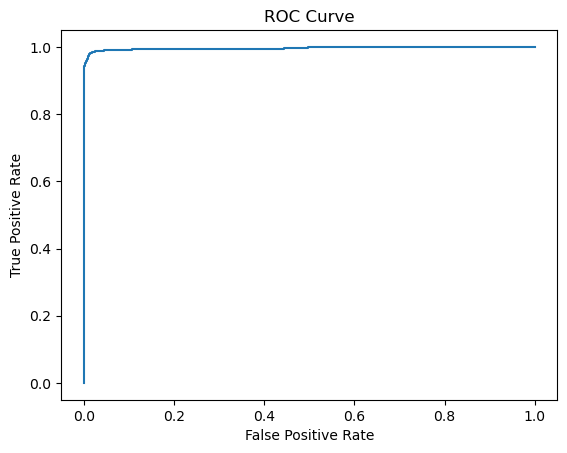

AUC-ROC Score: 0.995792639265118


In [27]:
from sklearn.metrics import roc_curve, RocCurveDisplay
from sklearn.metrics import roc_auc_score

y_scores = clf.predict_proba(X_test)[:, 1]

fpr, tpr, thresholds = roc_curve(y_test, y_scores)

roc_display = RocCurveDisplay(fpr=fpr, tpr=tpr)
roc_display.plot()
plt.title('ROC Curve')
plt.show()

auc_score = roc_auc_score(y_test, y_scores)

print("AUC-ROC Score:", auc_score)

# Random Forest
In addition to the logistic regression model, we also utilize a random forest model for predicting the probability of loan defaults. Given that random forest is a widely employed model in binary classification scenarios, we leverage its strengths for this task. Overall, we follow the same steps as with logistic regression.

[[9793    2]
 [ 141 1607]]
              precision    recall  f1-score   support

           0       0.99      1.00      0.99      9795
           1       1.00      0.92      0.96      1748

    accuracy                           0.99     11543
   macro avg       0.99      0.96      0.98     11543
weighted avg       0.99      0.99      0.99     11543



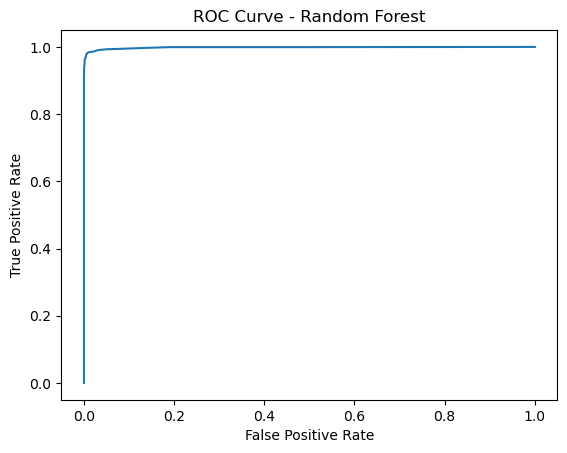

AUC-ROC Score: 0.998419428957239


In [28]:
from sklearn.ensemble import RandomForestClassifier
clf_rf = RandomForestClassifier(random_state=RAND_SEED)
clf_rf.fit(X_train, y_train)

y_pred_rf = clf_rf.predict(X_test)

print(confusion_matrix(y_test,y_pred_rf))
print(classification_report(y_test,y_pred_rf))

y_scores_rf = clf_rf.predict_proba(X_test)[:, 1]

fpr_rf, tpr_rf, thresholds_rf = roc_curve(y_test, y_scores_rf)

roc_display_rf = RocCurveDisplay(fpr=fpr_rf, tpr=tpr_rf)
roc_display_rf.plot()
plt.title('ROC Curve - Random Forest')
plt.show()

auc_score = roc_auc_score(y_test, y_scores_rf)

print("AUC-ROC Score:", auc_score)


Random forest model also performed remarkably well in predicting the default probability. The model displays exceptional precision (0.99) for both classes, and while it achieves perfect recall (1.00) for repaid loans, its recall for defaulted loans is slightly lower (0.92), highlighting a small number of false negatives. The overall accuracy remains high at 0.99, demonstrating the model's accuracy in making predictions. 

# Conclusion
This notebook is dedicated to investigating the optimal techniques for engineering features with minimal data loss. The primary objective is to ensure that the resulting cleaned dataset is well-suited for subsequent machine learning tasks. Through this exploration, we aim to strike a balance between enhancing features and retaining as much original information as possible.

Subsequent to the feature engineering process, the effectiveness of the refined dataset is evaluated using cross-validation techniques. The results reveal that both models possess the capability to predict default probabilities with an impressive overall accuracy of 99%, all while taking into account the inherent class imbalance within the data. This indicates that the models are not only adept at capturing meaningful patterns but also at effectively handling the challenge posed by imbalanced classes.